<h1 style="font-size:300%; color:blue;"> 🦆 NFL Starter EDA 🦆 </h1>

Modification to original =>=>  [https://www.kaggle.com/code/h0ngxuanli/comprehensive-starter-eda](https://www.kaggle.com/code/h0ngxuanli/comprehensive-starter-eda) - by [MACHINELEARNINGMAN](https://www.kaggle.com/h0ngxuanli)

<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Index</h3>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#🚀-Environment-Setting" role="tab" aria-controls="profile">🚀 Environment Setting<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#🚀-Helper-functions" role="tab" aria-controls="messages">🚀 Helper functions<span class="badge badge-primary badge-pill">2</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#🚀-EDA-(Exploratory-Data-Analysis)" role="tab" aria-controls="settings">🚀EDA (Exploratory Data Analysis)<span class="badge badge-primary badge-pill">3</span></a>


# 🚀 Environment Setting

In [1]:
import os
import pandas as pd
import numpy as np
import cv2
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import seaborn as sns
import plotly

In [2]:
import warnings
# warnings.filterwarnings("ignore")

In [3]:
ENV_DIR = '../input'
# DATA_DIR = f'{ENV_DIR}/nfl-player-contact-detection'
DATA_DIR = f'data'

In [4]:
# os.listdir(DATA_DIR)

In [5]:
# Training data
# -----------------------------------------------------------------------

# Bounding Box
train_df = pd.read_csv(f'{DATA_DIR}/train_labels.csv', parse_dates=["datetime"])
# train_df.info() =>  
#  #   Column           Dtype              
# ---  ------           -----              
#  0   contact_id       object             
#  1   game_play        object             
#  2   datetime         datetime64[ns, UTC]
#  3   step             int64              
#  4   nfl_player_id_1  int64              
#  5   nfl_player_id_2  object             
#  6   contact          int64 
# If your CSV file contains columns with a mixture of timezones, the default result will be an object-dtype column with strings, even with parse_dates.

# Tracking Information using Sensor
train_tracking_df = pd.read_csv(f'{DATA_DIR}/train_player_tracking.csv', parse_dates=["datetime"])
test_tracking_df = pd.read_csv(f'{DATA_DIR}/test_player_tracking.csv', parse_dates=["datetime"])

# Video metadata
train_metadata_df = pd.read_csv(f'{DATA_DIR}/train_video_metadata.csv', parse_dates=["start_time", "end_time", "snap_time"])
test_metadata_df = pd.read_csv(f'{DATA_DIR}/test_video_metadata.csv', parse_dates=["start_time", "end_time", "snap_time"])

# Baseline Prediction - Trained by images inside folder images/
train_predict_df = pd.read_csv(f'{DATA_DIR}/train_baseline_helmets.csv')
test_predict_df = pd.read_csv(f'{DATA_DIR}/test_baseline_helmets.csv')

# 🚀 Helper functions
- Get Image by frame
- Draw Bounding Box
- Video play
- Football Animation

<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Dealing with image and video</h3>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Get-Image-by-frame" role="tab" aria-controls="profile">Get Image by frame<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Draw-Bounding-Box" role="tab" aria-controls="messages">Draw Bounding Box<span class="badge badge-primary badge-pill">2</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#Video-Play" role="tab" aria-controls="settings">Video Play<span class="badge badge-primary badge-pill">3</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Football-Animation" role="tab" aria-controls="settings">Football Animation<span class="badge badge-primary badge-pill">4</span></a> 

<div class="alert alert-info" role="alert">
    <a data-toggle="list" href="#Index" role="tab" aria-controls="settings">☝🏻 Back to Index</a>
</div>

## Get Image by frame
> Get frame image from video



In [170]:
def get_frame_from_video(video_path, frame):
    video_path = f"{DATA_DIR}/train/{video_path}"
    

    # https://ffmpeg.org/download.html
#     frame = frame - 1    
#     !ffmpeg \
#         -hide_banner \
#         -loglevel fatal \
#         -nostats \
#         -i $video_path -vf "select=eq(n\,$frame)" \
#         -vframes 1 \
#         frame.png
    
#     img = Image.open('frame.png')
#     os.remove('frame.png')    
    
    cap = cv2.VideoCapture(video_path)    
    cap.set(cv2.CAP_PROP_POS_FRAMES,frame)
    ret, img = cap.read()
    print(img.shape)
    return img

(720, 1280, 3)


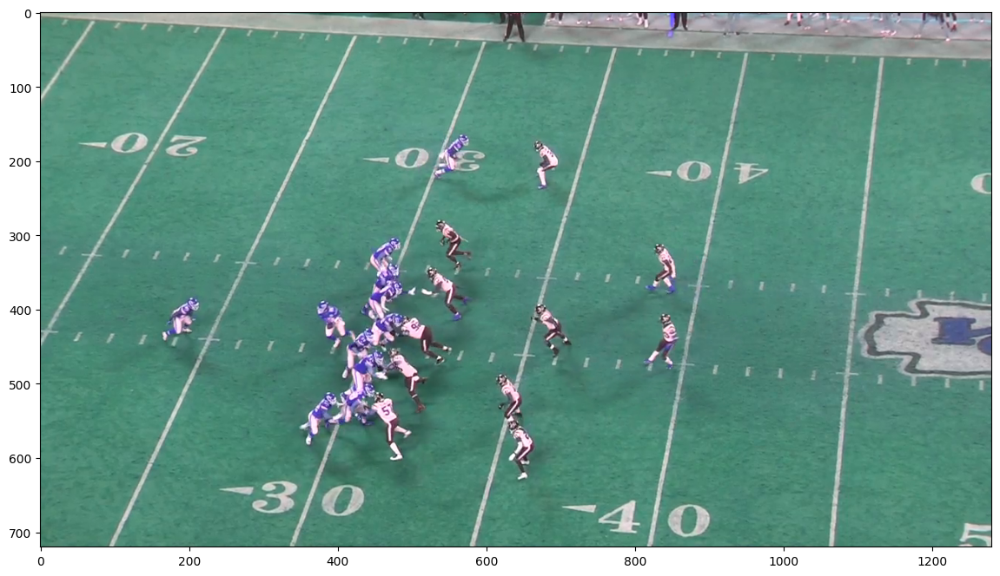

In [37]:
plt.figure(figsize=(20, 8))
plt.imshow(get_frame_from_video('58168_003392_Sideline.mp4', 320))
plt.show()


## Draw Bounding Box
> Just a simple bounding box drawing without label for EDA purpose

In [172]:
def draw_rect(image, bbox_df):
#     new_image = image.copy() # when image is in .png format.
    new_image = Image.fromarray(image) # when image is in numpy array.
    draw = ImageDraw.Draw(new_image)
    for _, (left, width, top, height) in bbox_df[['left', 'width', 'top', 'height']].iterrows():
        draw.rectangle(((left, top), (left + width, top + height)), outline=(0, 255, 0), width=2)
    return new_image

In [173]:
def frame_bbox(df, video_frame):
    video_name = '_'.join(video_frame.split('_')[:3]) + '.mp4'
    frame = int(video_frame.split('_')[-1])
    
    image = get_frame_from_video(video_name, frame)
    bbox_df = df.query('video == @video_name and frame == @frame')
    
    bbox_image = draw_rect(image, bbox_df)
    
    return bbox_image

(720, 1280, 3)


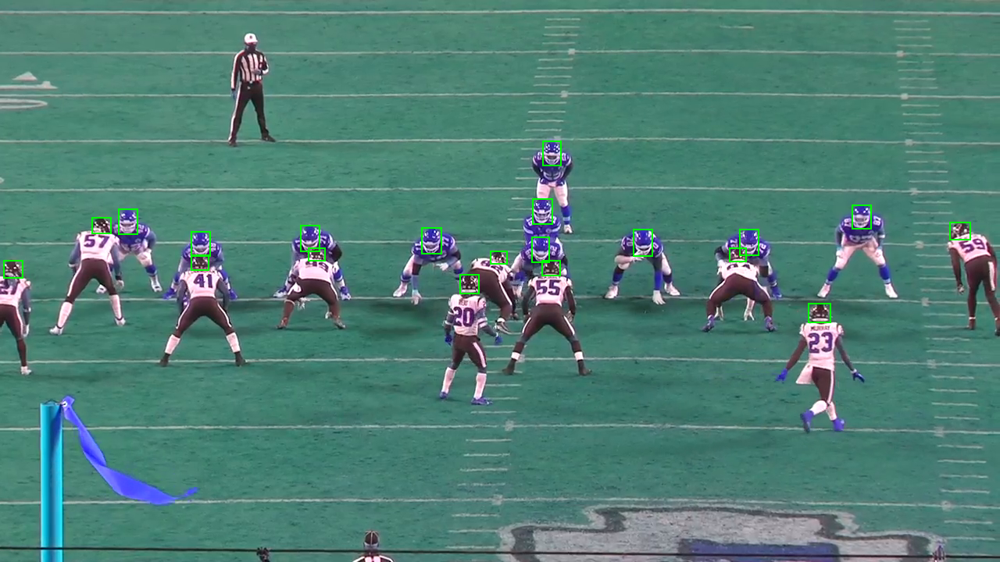

In [55]:
frame_bbox(train_predict_df, '58168_003392_Endzone_290')

## Video Play
> Let's enjoy the video and see whats the game looks like.

In [56]:
from IPython.display import Video, display

def video(video_path, ratio=0.7):
    nfl_video = Video(f"{DATA_DIR}/train/{video_path}",
                      embed=True,
                      height=int(720 * ratio),
                      width=int(1280 * ratio))
    return nfl_video
    
video('58168_003392_Endzone.mp4')

## Football Animation

> football animation made by `ammarnassanalhajali`

**Reference**
- https://www.kaggle.com/ammarnassanalhajali/nfl-big-data-bowl-2021-animating-players
- https://www.kaggle.com/robikscube/nfl-helmet-assignment-getting-started-guide

In [57]:
import plotly.express as px
import plotly.graph_objects as go
import plotly


def add_plotly_field(fig):
    # Reference https://www.kaggle.com/ammarnassanalhajali/nfl-big-data-bowl-2021-animating-players
    fig.update_traces(marker_size=20)
    
    fig.update_layout(paper_bgcolor='#29a500', plot_bgcolor='#29a500', font_color='white',
        width = 800,
        height = 600,
        title = "",
        
        xaxis = dict(
        nticks = 10,
        title = "",
        visible=False
        ),
        
        yaxis = dict(
        scaleanchor = "x",
        title = "Temp",
        visible=False
        ),
        showlegend= True,
  
        annotations=[
       dict(
            x=-5,
            y=26.65,
            xref="x",
            yref="y",
            text="ENDZONE",
            font=dict(size=16,color="#e9ece7"),
            align='center',
            showarrow=False,
            yanchor='middle',
            textangle=-90
        ),
        dict(
            x=105,
            y=26.65,
            xref="x",
            yref="y",
            text="ENDZONE",
            font=dict(size=16,color="#e9ece7"),
            align='center',
            showarrow=False,
            yanchor='middle',
            textangle=90
        )]  
        ,
        legend=dict(
        traceorder="normal",
        font=dict(family="sans-serif",size=12),
        title = "",
        orientation="h",
        yanchor="bottom",
        y=1.00,
        xanchor="center",
        x=0.5
        ),
    )
    ####################################################
        
    fig.add_shape(type="rect", x0=-10, x1=0,  y0=0, y1=53.3,line=dict(color="#c8ddc0",width=3),fillcolor="#217b00" ,layer="below")
    fig.add_shape(type="rect", x0=100, x1=110, y0=0, y1=53.3,line=dict(color="#c8ddc0",width=3),fillcolor="#217b00" ,layer="below")
    for x in range(0, 100, 10):
        fig.add_shape(type="rect", x0=x,   x1=x+10, y0=0, y1=53.3,line=dict(color="#c8ddc0",width=3),fillcolor="#29a500" ,layer="below")
    for x in range(0, 100, 1):
        fig.add_shape(type="line",x0=x, y0=1, x1=x, y1=2,line=dict(color="#c8ddc0",width=2),layer="below")
    for x in range(0, 100, 1):
        fig.add_shape(type="line",x0=x, y0=51.3, x1=x, y1=52.3,line=dict(color="#c8ddc0",width=2),layer="below")
    
    for x in range(0, 100, 1):
        fig.add_shape(type="line",x0=x, y0=20.0, x1=x, y1=21,line=dict(color="#c8ddc0",width=2),layer="below")
    for x in range(0, 100, 1):
        fig.add_shape(type="line",x0=x, y0=32.3, x1=x, y1=33.3,line=dict(color="#c8ddc0",width=2),layer="below")
    
    
    fig.add_trace(go.Scatter(
    x=[2,10,20,30,40,50,60,70,80,90,98], y=[5,5,5,5,5,5,5,5,5,5,5],
    text=["G","1 0","2 0","3 0","4 0","5 0","4 0","3 0","2 0","1 0","G"],
    mode="text",
    textfont=dict(size=20,family="Arail"),
    showlegend=False,
    ))
    
    fig.add_trace(go.Scatter(
    x=[2,10,20,30,40,50,60,70,80,90,98], y=[48.3,48.3,48.3,48.3,48.3,48.3,48.3,48.3,48.3,48.3,48.3],
    text=["G","1 0","2 0","3 0","4 0","5 0","4 0","3 0","2 0","1 0","G"],
    mode="text",
    textfont=dict(size=20,family="Arail"),
    showlegend=False,
    ))
    
    return fig

In [58]:
def football_animation(game_play):
    train_tracking_df["player"] = train_tracking_df["team"].str.upper().str[0]+train_tracking_df["jersey_number"].astype("str")
   
    train_tracking_df["track_time_count"] = (
        train_tracking_df.sort_values("datetime")
        .groupby("game_play")["datetime"]
        .rank(method="dense")
        .astype("int")
    )
    
    
    fig = px.scatter(
        train_tracking_df.query("game_play == @game_play")
        .groupby(["track_time_count"])
        .apply(lambda x: x.sort_values(["player"], ascending = False))# sort player number within the same tracking count (plotly scatter animation requirement),
        .reset_index(drop=True),
        
        x="x_position",
        y="y_position",
        range_x=[-10, 110],
        range_y=[-10, 53.3],
        hover_data=["player", "speed", "acceleration", "direction"],
        color="team",
        animation_frame="track_time_count",
        text="player",
        title=f"Animation of NGS data for game_play {game_play}",
    )

    fig.update_traces(textfont_size=10)
    fig = add_plotly_field(fig)
    fig.show()

In [59]:
football_animation('58168_003392')

# 🚀 EDA (Exploratory Data Analysis)

> We will focus on understanding the videos and csv files

<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Videos and CSV files</h3>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#🏈-[-Train-/-Test-]-video" role="tab" aria-controls="profile">🏈 [ Train / Test ] video<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#🏈-[-Train-/-Test-]-video-metadata.csv" role="tab" aria-controls="messages">🏈 [ Train / Test ] video metadata.csv<span class="badge badge-primary badge-pill">2</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#🏈-train_labels.csv" role="tab" aria-controls="messages">🏈 train_labels.csv<span class="badge badge-primary badge-pill">2</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#🏈-[-Train-/-Test-]-player-tracking.csv" role="tab" aria-controls="settings">🏈 [ Train / Test ] player tracking.csv<span class="badge badge-primary badge-pill">3</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#🏈-[-Train-/-Test-]-baseline-helmets.csv" role="tab" aria-controls="settings">🏈 [ Train / Test ] baseline helmets.csv<span class="badge badge-primary badge-pill">4</span></a>
    
<div class="alert alert-info" role="alert">
    <a data-toggle="list" href="#Index" role="tab" aria-controls="settings">☝🏻 Back to Index</a>
</div>

# 🏈 [ Train / Test ] video
> Let's understand the vidoes inside `train` and `test` folder

<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Questions</h3>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Is-test-videos-a-subset-of-train-videos?" role="tab" aria-controls="profile">Is test videos a subset of train videos?<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#How-many-train-videos-are-there?" role="tab" aria-controls="messages">How many train videos are there?<span class="badge badge-primary badge-pill">2</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#How-many-frames-per-video-/-all-videos?" role="tab" aria-controls="messages">How many frames per video / all videos?<span class="badge badge-primary badge-pill">2</span></a>  
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#Does-Sideline,-Endzone-Video-and-All29-has-same-frame?" role="tab" aria-controls="settings">Does Sideline, Endzone Video and All29 has same frame?<span class="badge badge-primary badge-pill">3</span></a>

<div class="alert alert-info" role="alert">
    <a data-toggle="list" href="#🚀-EDA-(Exploratory-Data-Analysis)" role="tab" aria-controls="settings">🚀 Back to EDA</a>
</div>

## Is test videos a subset of train videos?
> Yes!

In [8]:
train_videos = os.listdir(f'{DATA_DIR}/train')
    # train_videos =>
    # ['58168_003392_All29.mp4',
    #  '58168_003392_Endzone.mp4',
    #  '58168_003392_Sideline.mp4',
    # ...
    
test_videos = os.listdir(f'{DATA_DIR}/test')
len(train_videos), len(test_videos)

(720, 6)

In [9]:
set(test_videos).issubset(set(train_videos))

True

## How many train videos are there?
> Total 720! Sideline, Endzone and  video pair for every plays! This year, an additional view is provided, All29 which should include view of every player involved in the play. All29 video is not guaranteed to be time synced with the sideline and endzone.

- train 720 videos
    - Endzone 240
    - Sideline 240
    - All29 240
    

In [10]:
end_count = 0
side_count = 0
all_count = 0
endzone_list = []
sideline_list = []
all_list = []
for train_video in train_videos:
    name = train_video.split('.')[0]
    video_id, play_id, view = name.split('_')
    
    if view == "Endzone":
        endzone_list.append('_'.join([video_id, play_id]))
        end_count += 1
    elif view == "Sideline":
        sideline_list.append('_'.join([video_id, play_id]))
        side_count += 1
        
    else:
        all_list.append('_'.join([video_id, play_id]))
        all_count += 1

print(end_count, side_count, all_count)

240 240 240


In [65]:
# endzone_list =>
# ['58168_003392',
#  '58172_003247',
#  '58173_003606',
#  '58174_001792',
# ...

# every game video includes endzone and sideline view
len(set(endzone_list)), len(set(sideline_list)), set(endzone_list) == set(sideline_list)

(240, 240, True)

In [66]:
# videos inside "train folder" matches the video list inside the train_labels.csv
set([i[:12] for i in train_videos]) == set(train_df.game_play.unique())

True

In [11]:
len(set([i[:12] for i in train_videos])), len(set(train_df.game_play.unique()))

(240, 240)

## How many frames per video ?
> - Most videos have 700~800 frames.
> - " Frames count plot " for both " endzone and sideline " view is same.

In [23]:
def get_total_frame(video_path):
    cap = cv2.VideoCapture(f"{DATA_DIR}/train/{video_path}")
    property_id = int(cv2.CAP_PROP_FRAME_COUNT) 
    length = int(cv2.VideoCapture.get(cap, property_id))
    return length

# def add_view(group): # add all29 view to meta data dataframe
#     first_row = group.iloc[[0]]
#     first_row.iloc[:,1:] = np.nan
#     first_row['view'] = "All29"
#     return first_row.append(group)

def add_view_e(group): 
    first_row = group.iloc[[0]]
    first_row.iloc[:,1:] = np.nan
    first_row['view'] = "Endzone"
    return first_row.append(group)

def add_view_s(group): 
    first_row = group.iloc[[0]]
    first_row.iloc[:,1:] = np.nan
    first_row['view'] = "Sideline"
    return first_row.append(group)

In [30]:
train_metadata_df.head(3)

,game_play,game_key,play_id,view,start_time,end_time,snap_time
0,58168_003392,58168,3392,Endzone,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
1,58168_003392,58168,3392,Sideline,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
2,58172_003247,58172,3247,Endzone,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13 19:30:47.414000+00:00


In [24]:
train_metadata_all_df = train_metadata_df.groupby("game_play").apply(add_view_e).reset_index(drop=True)

train_video = (train_metadata_all_df.game_play + "_" + train_metadata_all_df.view + ".mp4").to_frame()
train_video.columns = ["video_name"]
train_video["frames"] = train_video["video_name"].apply(get_total_frame)

<AxesSubplot:xlabel='frames', ylabel='Count'>

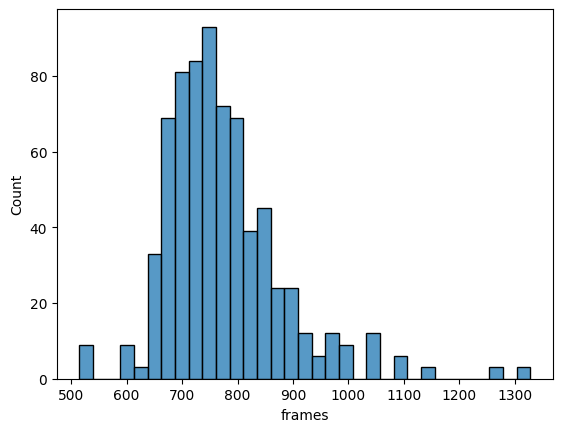

In [25]:
# frames vs count of endzone videos
sns.histplot(train_video.frames) 

In [27]:
train_metadata_all_df = train_metadata_df.groupby("game_play").apply(add_view_s).reset_index(drop=True)

train_video = (train_metadata_all_df.game_play + "_" + train_metadata_all_df.view + ".mp4").to_frame()
train_video.columns = ["video_name"]
train_video["frames"] = train_video["video_name"].apply(get_total_frame)

<AxesSubplot:xlabel='frames', ylabel='Count'>

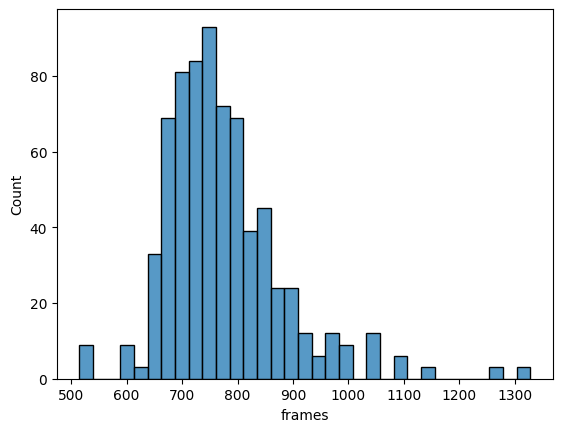

In [28]:
# frames vs count of sideline videos
sns.histplot(train_video.frames) 

## Does Sideline, Endzone Videos has same frame?
> 11 game plays out of 240 doesn't match and the minimum difference is of 1 frame and the maximum difference is of 24 frames.

In [33]:
def add_view_e_s(group): 
    first_row = group.iloc[[0]]
    first_row.iloc[:,1:] = np.nan
    first_row['view'] != "All29"
    return first_row.append(group)


In [34]:
train_metadata_df.view.value_counts()

Endzone     240
Sideline    240
Name: view, dtype: int64

In [35]:
train_metadata_all_df = train_metadata_df.groupby("game_play").apply(add_view_e_s).reset_index(drop=True)

In [38]:
not_match_video = []
no_match = 0


train_video["game_play"] = train_metadata_all_df.game_play
train_video["view"] = train_metadata_all_df.view

for play in train_predict_df.game_play.unique():
    end_frame_n = train_video.query('game_play == @play and view == "Endzone"').frames.values[0]
    side_frame_n = train_video.query('game_play == @play and view == "Sideline"').frames.values[0]
    # all_frame_n = train_video.query('game_play == @play and view == "All29"').frames.values[0]
    
    if end_frame_n != side_frame_n: # all29 is not guaranteed to be synced with end and side
        no_match +=1
        not_match_video.append(play)
        print(f'Not same at playID {play} endzone [{end_frame_n}] sideline [{side_frame_n}]  difference [{abs(end_frame_n - side_frame_n)}]')
print("\n")
print(f'{no_match} of {len(train_predict_df.game_play.unique())} videos are not matched for endzone and sideline. ')

Not same at playID 58261_000085 endzone [768] sideline [756]  difference [12]
Not same at playID 58261_002636 endzone [655] sideline [649]  difference [6]
Not same at playID 58267_001152 endzone [840] sideline [839]  difference [1]
Not same at playID 58282_000120 endzone [672] sideline [683]  difference [11]
Not same at playID 58282_001429 endzone [744] sideline [768]  difference [24]
Not same at playID 58282_004520 endzone [840] sideline [843]  difference [3]
Not same at playID 58285_004176 endzone [719] sideline [720]  difference [1]
Not same at playID 58325_003176 endzone [788] sideline [795]  difference [7]
Not same at playID 58325_003506 endzone [723] sideline [726]  difference [3]
Not same at playID 58503_000869 endzone [875] sideline [876]  difference [1]
Not same at playID 58518_003619 endzone [703] sideline [704]  difference [1]


11 of 240 videos are not matched for endzone and sideline. 


# 🏈 [ Train / Test ] video metadata.csv
> Metadata for each sideline and endzone video file including the play start/end/ball snap timestamp information to be used to sync with player tracking data.

<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Questions</h3>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#How-many-games-and-plays?" role="tab" aria-controls="profile">How many games and plays?<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#How-many-plays-per-game?" role="tab" aria-controls="messages">How many plays per game?<span class="badge badge-primary badge-pill">2</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#What-is-the-duration-of-each-play?" role="tab" aria-controls="settings">What is the duration of each play?<span class="badge badge-primary badge-pill">3</span></a>
 
     
<div class="alert alert-info" role="alert">
    <a data-toggle="list" href="#🚀-EDA-(Exploratory-Data-Analysis)" role="tab" aria-controls="settings">🚀 Back to EDA</a>
</div>

## How many games and plays?
> `game_key` and `play_id` has unique ID
- 149 games
- 233 plays

In [39]:
train_metadata_df.game_key.nunique()

149

In [40]:
train_metadata_df.play_id.nunique()

233

In [42]:
# viewing "play ids" for some "game keys".
train_metadata_df.groupby('game_key')['play_id'].unique().tail()

game_key
58577          [2486]
58579          [3527]
58580    [1136, 3294]
58581            [40]
58582          [3121]
Name: play_id, dtype: object

## How many plays per game?
- 89 games has only 1 play
- 42 games has 2 plays
- 10 game has 3 plays
- 5 game has 4 plays
- 1 game has 5 plays
- 2 game has 6 plays

In [48]:
# train_metadata_df.groupby('game_key')['play_id'].nunique().reset_index().tail() =>
#      game_key  play_id
# 144     58577        1
# 145     58579        1
# 146     58580        2
# 147     58581        1
# 148     58582        1

play_per_game = train_metadata_df.groupby('game_key')['play_id'].nunique().reset_index().groupby('play_id')['game_key'].unique().to_dict()
for key,value in play_per_game.items():
    print(f" {len(value)} games have {key} plays ")

 89 games have 1 plays 
 42 games have 2 plays 
 10 games have 3 plays 
 5 games have 4 plays 
 1 games have 5 plays 
 2 games have 6 plays 


## What is the duration of each play?
> 8.6s ~ 22s per play, mostly 12s

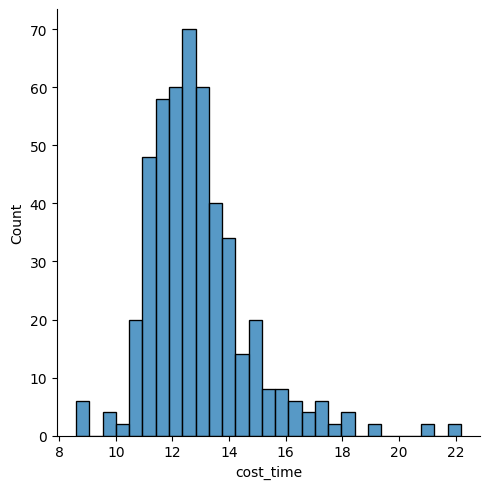

In [49]:
train_metadata_df["cost_time"] = (train_metadata_df["end_time"]-train_metadata_df["start_time"]).dt.total_seconds()
sns.displot(train_metadata_df["cost_time"])

In [50]:
# estimated frames per play (@ 59.94 frames per second).
round(train_metadata_df["cost_time"] * 59.94).astype(int) 

0       710
1       710
2      1086
3      1086
4      1134
       ... 
475     828
476     724
477     724
478     842
479     842
Name: cost_time, Length: 480, dtype: int32

# 🏈 train_labels.csv
> Include contact information for each pair of players and ground in each timestamp.

<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Questions</h3>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Do-all-contacts-happen-after-the-ball-snap?" role="tab" aria-controls="profile">Do all contacts happen after the ball snap?<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Does-every-moment-have-every-combination-of-22-players-and-ground?" role="tab" aria-controls="profile">Does every moment have every combination of 22 players and ground?<span class="badge badge-primary badge-pill">2</span></a>

     
<div class="alert alert-info" role="alert">
    <a data-toggle="list" href="#🚀-EDA-(Exploratory-Data-Analysis)" role="tab" aria-controls="settings">🚀 Back to EDA</a>
</div>

## Do all contacts happen after the ball snap?
> Yes, the contacts happen at or after the ball snap

<AxesSubplot:xlabel='step', ylabel='Count'>

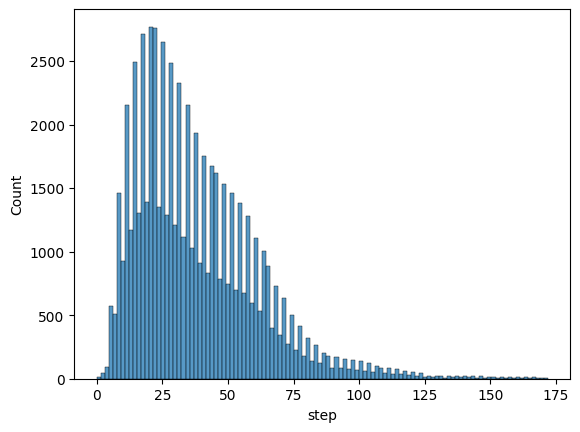

In [51]:
# step => denotes the timestep within play relative to the "play start". incrementing by 1 every 0.1 seconds.
sns.histplot((train_df.query("contact == 1").step))

In [63]:
# 8 contact happened just at the point of the ball snap.
train_df.query("contact == 1").step.value_counts().sort_index()

0       8
1       8
2      12
3      32
4      93
       ..
168     4
169     4
170     4
171     4
172     4
Name: step, Length: 173, dtype: int64

## Does every moment have every combination of 22 players and ground?
> Yes, each play contains every contact pairs of players and ground.

In [64]:
# 11*21 = 231 (every 1 player can have contact with other 21 players)
# 22 (every 1 player can have contact with ground)
231+22 # combinations for 22 players and ground

253

##### Note: If, after contact by an opponent, any part of a runner’s leg above the ankle or any part of his arm above the wrist touches the ground, the runner is down.

In [98]:
# every game_play has 22 contact_id relative to target ground. 
# train_df[(train_df['nfl_player_id_2']=='G') & (train_df['contact']==0)].groupby(["game_play", "datetime"]).contact_id.count().reset_index()
train_df[(train_df['nfl_player_id_2']=='G')].groupby(["game_play", "datetime"]).contact_id.count().reset_index().tail()

,game_play,datetime,contact_id
18663,58582_003121,2021-10-12 02:42:28.700000+00:00,22
18664,58582_003121,2021-10-12 02:42:28.800000+00:00,22
18665,58582_003121,2021-10-12 02:42:28.900000+00:00,22
18666,58582_003121,2021-10-12 02:42:29+00:00,22
18667,58582_003121,2021-10-12 02:42:29.100000+00:00,22


In [99]:
train_df[train_df['nfl_player_id_2']!='G'].groupby(["game_play", "datetime"]).contact_id.count().reset_index().tail()

,game_play,datetime,contact_id
18663,58582_003121,2021-10-12 02:42:28.700000+00:00,231
18664,58582_003121,2021-10-12 02:42:28.800000+00:00,231
18665,58582_003121,2021-10-12 02:42:28.900000+00:00,231
18666,58582_003121,2021-10-12 02:42:29+00:00,231
18667,58582_003121,2021-10-12 02:42:29.100000+00:00,231


In [100]:
train_df.groupby(["game_play", "datetime"]).contact_id.count().reset_index().tail()

,game_play,datetime,contact_id
18663,58582_003121,2021-10-12 02:42:28.700000+00:00,253
18664,58582_003121,2021-10-12 02:42:28.800000+00:00,253
18665,58582_003121,2021-10-12 02:42:28.900000+00:00,253
18666,58582_003121,2021-10-12 02:42:29+00:00,253
18667,58582_003121,2021-10-12 02:42:29.100000+00:00,253


In [96]:
train_df.groupby(["game_play", "datetime"]).contact_id.count().reset_index().query("contact_id!=253").game_play.unique()

array(['58538_002774'], dtype=object)

In [97]:
# the play only has 21 players on the filed
video('58538_002774_Endzone.mp4')

NameError: name 'video' is not defined

# 🏈 [ Train / Test ] player tracking.csv
> Tracking information of the players that is used with videos to map the helmet label

<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Questions</h3>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#How-many-players-per-game?" role="tab" aria-controls="settings">How many players per game?<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#How-many-players-exist?" role="tab" aria-controls="settings">How many players exist?<span class="badge badge-primary badge-pill">2</span></a>   
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Is-ball-snap-is-the-starting-point-of-the-game?" role="tab" aria-controls="messages">Is ball snap is the starting point of the game?<span class="badge badge-primary badge-pill">3</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#Does-track-information-always-track-22-players-every-moment?" role="tab" aria-controls="settings">Does track information always track 22 players every moment?<span class="badge badge-primary badge-pill">4</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Why-only-21-players-are-tracked?" role="tab" aria-controls="settings">Why only 21 players are tracked?<span class="badge badge-primary badge-pill">5</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#Does-tracking-information-recorded-longer-than-video?" role="tab" aria-controls="settings">Does tracking information recorded longer than video?¶<span class="badge badge-primary badge-pill">6</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#Does-all-trackings-recorded-before-the-ball-snap?" role="tab" aria-controls="settings">Does all trackings recorded before the ball snap?<span class="badge badge-primary badge-pill">7</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#Do-plays-have-consistent-player-numbers-while-beeing-tracked?" role="tab" aria-controls="settings">Do plays have consistent player numbers while beeing tracked?<span class="badge badge-primary badge-pill">8</span></a>

    
<div class="alert alert-info" role="alert">
    <a data-toggle="list" href="#🚀-EDA-(Exploratory-Data-Analysis)" role="tab" aria-controls="settings">🚀 Back to EDA</a>
</div>

## How many players per game?
> Mostly 22 players per game. 1 game include 21 players

In [101]:
# train_df.groupby(['gameKey', 'playID', 'view'])['label'].nunique().value_counts()

train_tracking_df.groupby(['game_play', 'play_id'])['nfl_player_id'].nunique().value_counts()

22    239
21      1
Name: nfl_player_id, dtype: int64

In [102]:
train_tracking_df.query("game_play == '58580_001136'").nfl_player_id.nunique()

22

In [103]:
# check what game does only 21 players are running for?
train_tracking_df.groupby(['game_play', 'play_id'])['nfl_player_id'].nunique().reset_index().query("nfl_player_id == 21")

,game_play,play_id,nfl_player_id
197,58538_002774,2774,21


## How many players exist?
> 1687 players exist in 149 games. Out of 149, 88 games have exact 22 players in plays.
- Home and Away both have 99 numbers

In [104]:
train_tracking_df.nfl_player_id.nunique()

1687

In [108]:
# train_tracking_df.groupby("game_key").nfl_player_id.nunique() => 
# game_key
# 58168    22
#          ..
# 58580    44
# 58581    22
# 58582    22
# Name: nfl_player_id, Length: 149, dtype: int64

# examine the "number of games" with "player count" as index.
train_tracking_df.groupby("game_key").nfl_player_id.nunique().value_counts().head(4)

22    88
44    17
49     5
43     4
Name: nfl_player_id, dtype: int64

In [109]:
home_players = train_tracking_df.query('team == "home"').jersey_number.unique()
visitor_players = train_tracking_df.query('team == "away"').jersey_number.unique()

home_players.sort(), visitor_players.sort()
home_players, visitor_players

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
        35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
        52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
        69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
       dtype=int64),
 array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
        35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
        52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
        69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
       dtype=int64))

In [110]:
len(home_players), len(visitor_players)

(99, 99)

In [111]:
set(home_players) - set(visitor_players)

set()

## Is ball snap is the starting point of the game?
> yes! It occurs only one time per play
- Before snap players has small acceleration.
- After snap they start to run!


In [112]:
train_tracking_df.head(2)

,game_play,game_key,play_id,nfl_player_id,datetime,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa
0,58580_001136,58580,1136,44830,2021-10-10 21:08:20.900000+00:00,-108,away,CB,22,61.59,42.60,1.11,0.11,320.33,263.93,0.71,-0.64
1,58580_001136,58580,1136,47800,2021-10-10 21:08:20.900000+00:00,-108,away,DE,97,59.48,26.81,0.23,0.01,346.84,247.16,1.29,0.90


In [115]:
# play starting time - 240 endzone and sideline videos.
#len(train_tracking_df[train_tracking_df.step == 0].groupby("datetime"))
len(train_tracking_df[train_tracking_df.step == 0].groupby("game_play"))

240

<AxesSubplot:xlabel='acceleration', ylabel='Count'>

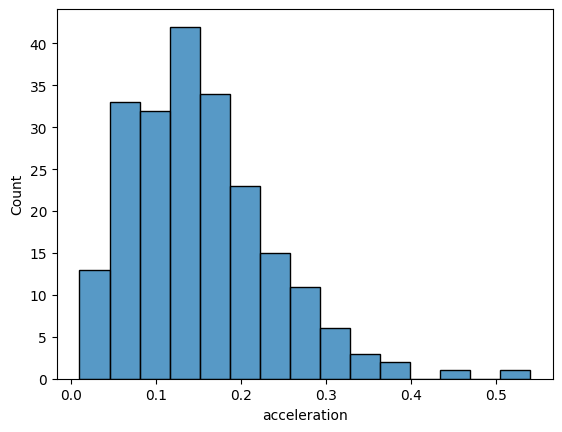

In [116]:
# wide recivers are fast runners
# before the ball snap the movement of "wide receivers" is low
play = train_tracking_df.query('game_play == "58580_001136" and position == "WR"')
sns.histplot(play[play.step < 0].acceleration)

<AxesSubplot:xlabel='acceleration', ylabel='Count'>

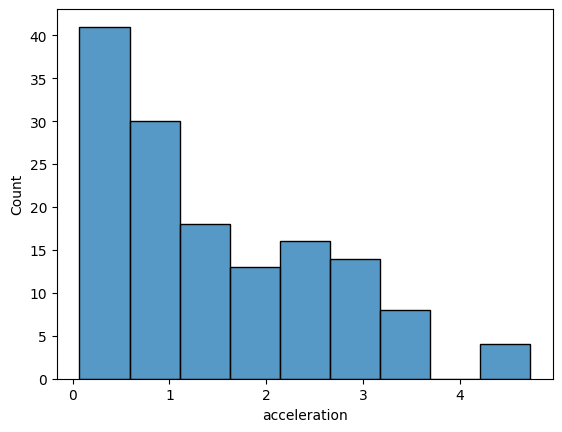

In [117]:
# wide receivers are fast runners
# after the ball snap the movement of "wide receivers" is fast
play = train_tracking_df.query('game_play == "58580_001136" and position == "WR"')
sns.histplot(play[play.step > 0].acceleration)

## Does track information always track 22 players every moment?
> No! Mostly 22 players are tracked but in one play less than 22 are tracked

In [139]:
train_tracking_df.groupby(['play_id', 'datetime']).count()['nfl_player_id']

play_id  datetime                        
40       2021-10-11 00:22:40.400000+00:00    22
         2021-10-11 00:22:40.500000+00:00    22
         2021-10-11 00:22:40.600000+00:00    22
         2021-10-11 00:22:40.700000+00:00    22
         2021-10-11 00:22:40.800000+00:00    22
                                             ..
4644     2020-09-13 23:28:38.300000+00:00    22
         2020-09-13 23:28:38.400000+00:00    22
         2020-09-13 23:28:38.500000+00:00    22
         2020-09-13 23:28:38.600000+00:00    22
         2020-09-13 23:28:38.700000+00:00    22
Name: nfl_player_id, Length: 61509, dtype: int64

In [132]:
# train_tracking_df.groupby(['play_id', 'datetime']).count()['nfl_player_id'] => 
# play_id  datetime                        
# 40       2021-10-11 00:22:40.400000+00:00    22
#          2021-10-11 00:22:40.500000+00:00    22
#          2021-10-11 00:22:40.600000+00:00    22
#          2021-10-11 00:22:40.700000+00:00    22
#          2021-10-11 00:22:40.800000+00:00    22
#                                              ..
#                                              ..
# 4644     2020-09-13 23:28:38.300000+00:00    22
#          2020-09-13 23:28:38.400000+00:00    22
#          2020-09-13 23:28:38.500000+00:00    22
#          2020-09-13 23:28:38.600000+00:00    22
#          2020-09-13 23:28:38.700000+00:00    22
# Name: nfl_player_id, Length: 61509, dtype: int64


# In 61364 datetimes/events, 22 players are present/viewed.
# In 145 datetimes/events, 21 players are present/viewed.
train_tracking_df.groupby(['play_id', 'datetime']).count()['nfl_player_id'].value_counts()

22    61364
21      145
Name: nfl_player_id, dtype: int64

## Why only 21 players are tracked?
> This happened in the play where only 21 players on the field

In [127]:
player_n_df = train_tracking_df.groupby(['play_id', 'datetime']).count()['nfl_player_id'].reset_index()
player_n_df.head(5)

,play_id,datetime,nfl_player_id
0,40,2021-10-11 00:22:40.400000+00:00,22
1,40,2021-10-11 00:22:40.500000+00:00,22
2,40,2021-10-11 00:22:40.600000+00:00,22
3,40,2021-10-11 00:22:40.700000+00:00,22
4,40,2021-10-11 00:22:40.800000+00:00,22


In [129]:
player_n_df.query('nfl_player_id == 21').head(5)

,play_id,datetime,nfl_player_id
38839,2774,2021-09-26 19:07:03.100000+00:00,21
38840,2774,2021-09-26 19:07:03.200000+00:00,21
38841,2774,2021-09-26 19:07:03.300000+00:00,21
38842,2774,2021-09-26 19:07:03.400000+00:00,21
38843,2774,2021-09-26 19:07:03.500000+00:00,21


In [130]:
player_n_df.query('nfl_player_id == 21').play_id.nunique()

1

In [140]:
# "play id" in which 21 players are viewed, has 145 datetimes/events.
player_n_df.query('nfl_player_id == 21').play_id.count()

145

In [ ]:
# this is the situation where 21 player on the court
video("58538_002774_Endzone.mp4")

## Does tracking information recorded longer than video?
> The tracking time is usually longer than the relative video. 

<AxesSubplot:ylabel='Count'>

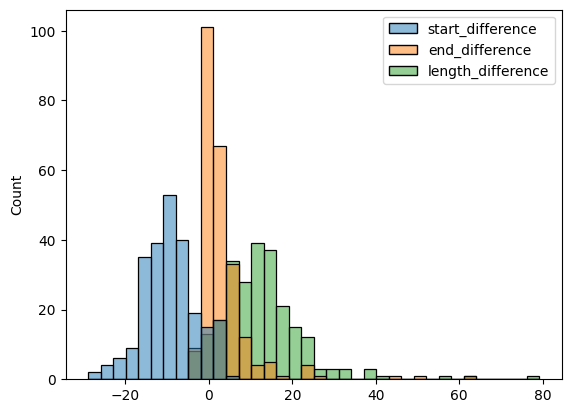

In [144]:
# pd.concat([train_tracking_df.groupby(['game_play']).datetime.min(),train_tracking_df.groupby(['game_play']).datetime.max()],axis = 1).reset_index() =>
# 		game_play		datetime							datetime
# 0		58168_003392	2020-09-11 03:01:29.600000+00:00	2020-09-11 03:01:57.300000+00:00
# 1		58172_003247	2020-09-13 19:30:20.200000+00:00	2020-09-13 19:30:59.900000+00:00
# 2		58173_003606	2020-09-13 19:44:55.200000+00:00	2020-09-13 19:45:25.400000+00:00
# ...
                        
train_tracking_time = pd.concat([train_tracking_df.groupby(['game_play']).datetime.min(),train_tracking_df.groupby(['game_play']).datetime.max()],axis = 1).reset_index()
train_tracking_time.columns = ["game_play","tracking_start_time", "tracking_end_time"]
train_video_time = train_metadata_df[train_metadata_df.view == "Sideline"][["game_play","start_time", "end_time", "snap_time"]].copy()

train_video_time.columns = ["game_play","video_start_time", "video_end_time", "video_snap_time"]

# train_video_time.iloc[:,:-1] => capture all rows and columns leaving the last column.
time_difference = pd.merge(train_tracking_time, train_video_time.iloc[:,:-1], on = "game_play")
time_difference["start_difference"] = (time_difference["tracking_start_time"]-time_difference["video_start_time"]).dt.total_seconds()
time_difference["end_difference"] = (time_difference["tracking_end_time"]-time_difference["video_end_time"]).dt.total_seconds()
time_difference["length_difference"] = (time_difference["end_difference"]-time_difference["start_difference"])

# start_difference => difference in "play" start time present in "tracking_df" and "video metadata_df".
# end_difference => difference in "play" end time present in "tracking_df" and "video metadata_df".
# length_difference => difference in above two differences.
# The tracking time is usually longer than the relative video. => positive bars are more in histogram.
sns.histplot(time_difference.iloc[:,-3:])

## Does all trackings recorded before the ball snap?
> Yes! All plays are recorded before the ball snap!

In [154]:
# play starts at the 5s of train_metadata_df
# snap_time: The timestamp when the play starts within the video. This is 5 seconds (300 frames) into the video.
# every tracking starts before the play starts

time_difference["snap_offset"] = (time_difference["tracking_start_time"]-train_video_time["video_snap_time"].reset_index(drop = True)).dt.total_seconds()

len(time_difference.query("snap_offset >= 0"))

0

# 🏈 [ Train / Test ] baseline helmets.csv
>The winning model from last year's competition was used to predict the bbox of train/test videos.


<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Questions</h3>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#Does-frames-in-train_baseline_helmets.csv-match-with-the-frame-in-videos?" role="tab" aria-controls="profile">Does frames in train_baseline_helmets.csv match with the frame in videos?<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#How-many-bbox-was-predicted-for-1-frame?" role="tab" aria-controls="profile">How many bbox was predicted for 1 frame?<span class="badge badge-primary badge-pill">2</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#What-is-the-helmet-size-inside-the-video?" role="tab" aria-controls="profile">What is the helmet size inside the video?<span class="badge badge-primary badge-pill">3</span></a>
<div class="alert alert-info" role="alert">
    <a data-toggle="list" href="#🚀-EDA-(Exploratory-Data-Analysis)" role="tab" aria-controls="settings">🚀 Back to EDA</a>
</div>

In [155]:
# Endzone2 should be ignored
# This was a mistake on "competition host" part. Please ignore any rows in the train_baseline_helmets.csv where the view column value is "Endzone2"

train_predict_df = train_predict_df[train_predict_df.view != "Endzone2"]
train_predict_df.view.value_counts()

Sideline    2103865
Endzone     1673235
Name: view, dtype: int64

## Does frames in train_baseline_helmets.csv match with the frame in videos?
> The video frames are usually 1 or 2 more than those in train_baseline_helmets.csv (at the end of videos, the helmet detection boxes disappear)

In [156]:
def get_total_frame(video_path):
    cap = cv2.VideoCapture(f"{DATA_DIR}/train/{video_path}")
    property_id = int(cv2.CAP_PROP_FRAME_COUNT) 
    length = int(cv2.VideoCapture.get(cap, property_id))
    return length

In [162]:
# train_predict_df.groupby('video').frame.max() => 
# video
# 58168_003392_Endzone.mp4      709
# 58168_003392_Sideline.mp4     709
#                              ... 
# 58582_003121_Sideline.mp4     842
# Name: frame, Length: 480, dtype: int64

play2frame = train_predict_df.groupby('video').frame.max().to_dict()

<AxesSubplot:ylabel='Count'>

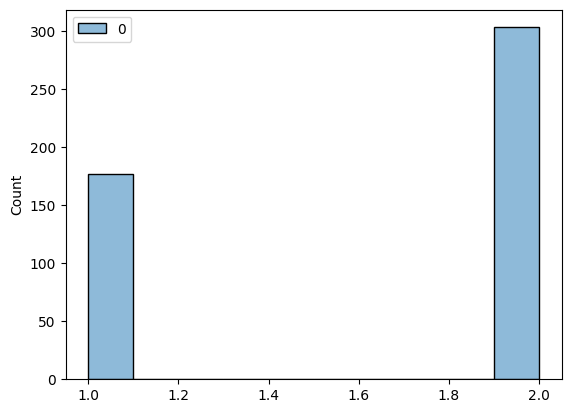

In [158]:
for video_name, label_frame_n in play2frame.items():
    video_frame_n = get_total_frame(video_name)
    play2frame[video_name] = int(video_frame_n-label_frame_n)
sns.histplot(play2frame.values()) 

## How many bbox was predicted for 1 frame?
> The model used for predicting the bounding box predicts sideline persons head as helmet too

- 82 bbox was predicted in max for 1 frame
- 2 bbox was predicted in min for 1 frame

In [163]:
# 22 bbox was predicted in max for 1 frame
train_predict_df.groupby(['video' ,'frame']).count()['left'].max()

22

In [164]:
# 1 bbox was predicted in max for 1 frame
train_predict_df.groupby(['video' ,'frame']).count()['left'].min()

1

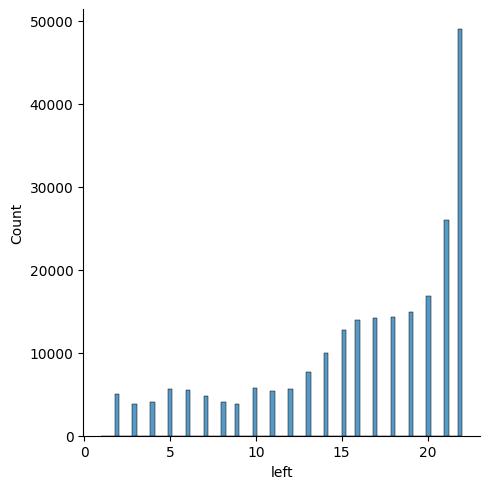

In [165]:
# bbox number doesn't seem quite right
sns.displot(train_predict_df.groupby(['video' ,'frame']).count()['left']);

In [166]:
train_predict_df.groupby(['video' ,'frame']).count().query('left == 15')

game_play  game_key  play_id  view  \
video                     frame                                       
58168_003392_Endzone.mp4  493           15        15       15    15   
                          495           15        15       15    15   
                          496           15        15       15    15   
                          497           15        15       15    15   
                          524           15        15       15    15   
...                                    ...       ...      ...   ...   
58582_003121_Sideline.mp4 722           15        15       15    15   
                          723           15        15       15    15   
                          724           15        15       15    15   
                          725           15        15       15    15   
                          733           15        15       15    15   

                                 nfl_player_id  player_label  left  width  \
video                     frame                                             
58168_003392_Endzone.mp4  493               15            15    15     15   
                          495               15            15    15     15   
                          496               15            15    15     15   
                          497               15            15    15     15   
                          524               15            15    15     15   
...                                        ...           ...   ...    ...   
58582_003121_Sideline.mp4 722               15            15    15     15   
                          723               15            15    15     15   
                          724               15            15    15     15   
                          725               15            15    15     15   
                          733               15            15    15     15   

                                 top  height  
video                     frame               
58168_003392_Endzone.mp4  493     15      15  
                          495     15      15  
                          496     15      15  
                          497     15      15  
                          524     15      15  
...                              ...     ...  
58582_003121_Sideline.mp4 722     15      15  
                          723     15      15  
                          724     15      15  
                          725     15      15  
                          733     15      15  

[12729 rows x 10 columns]

(720, 1280, 3)


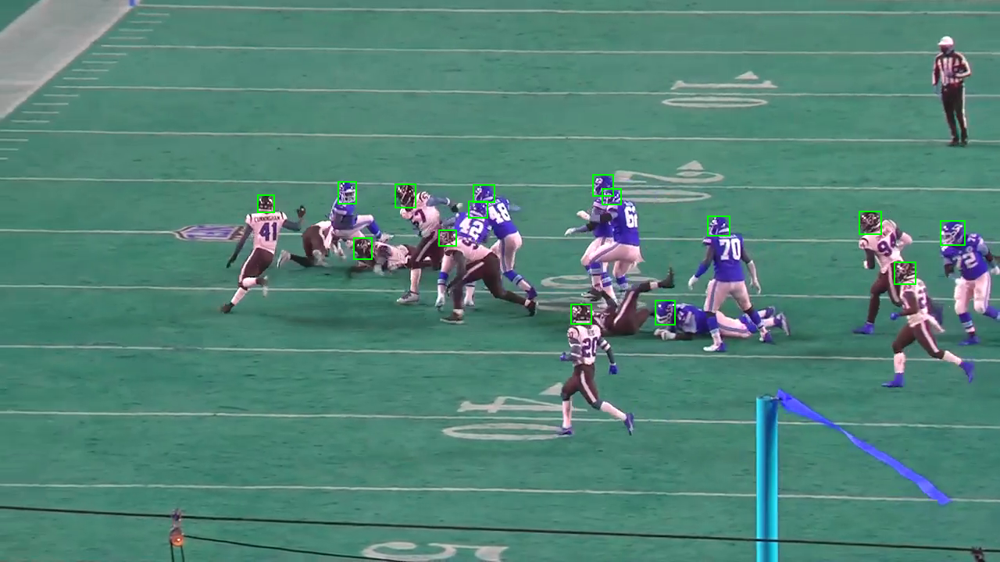

In [174]:
frame_bbox(train_predict_df, '58168_003392_Endzone_493')

In [175]:
train_predict_df.groupby(['video' ,'frame']).count().query('left == 1')

game_play  game_key  play_id  view  \
video                     frame                                       
58284_002768_Endzone.mp4  661            1         1        1     1   
                          662            1         1        1     1   
                          663            1         1        1     1   
                          664            1         1        1     1   
                          665            1         1        1     1   
                          666            1         1        1     1   
                          667            1         1        1     1   
58348_004222_Sideline.mp4 783            1         1        1     1   
58516_003014_Endzone.mp4  595            1         1        1     1   
58525_003852_Endzone.mp4  587            1         1        1     1   

                                 nfl_player_id  player_label  left  width  \
video                     frame                                             
58284_002768_Endzone.mp4  661                1             1     1      1   
                          662                1             1     1      1   
                          663                1             1     1      1   
                          664                1             1     1      1   
                          665                1             1     1      1   
                          666                1             1     1      1   
                          667                1             1     1      1   
58348_004222_Sideline.mp4 783                1             1     1      1   
58516_003014_Endzone.mp4  595                1             1     1      1   
58525_003852_Endzone.mp4  587                1             1     1      1   

                                 top  height  
video                     frame               
58284_002768_Endzone.mp4  661      1       1  
                          662      1       1  
                          663      1       1  
                          664      1       1  
                          665      1       1  
                          666      1       1  
                          667      1       1  
58348_004222_Sideline.mp4 783      1       1  
58516_003014_Endzone.mp4  595      1       1  
58525_003852_Endzone.mp4  587      1       1

(720, 1280, 3)


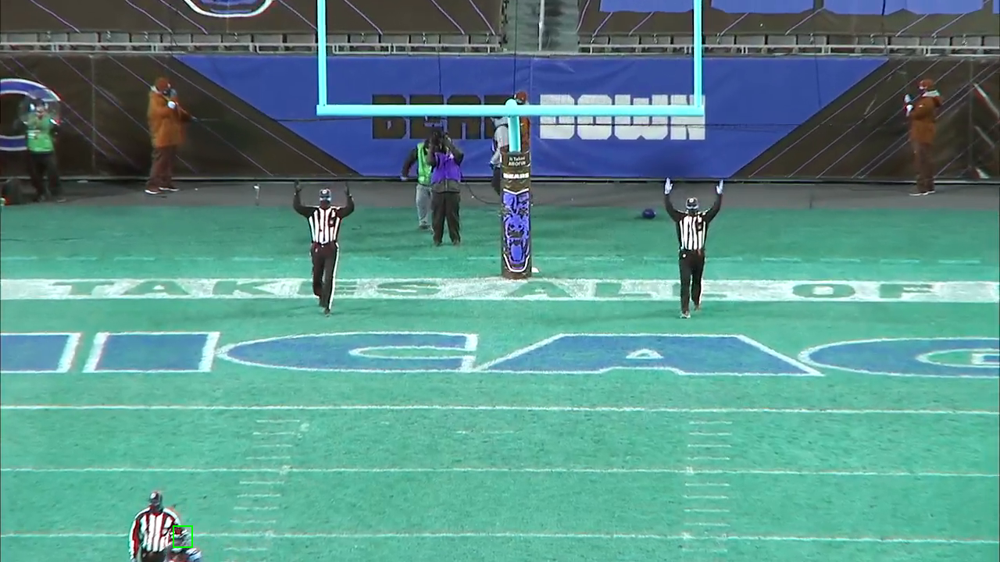

In [176]:
frame_bbox(train_predict_df, '58284_002768_Endzone_661')

## What is the helmet size inside the video?
- 6786 is the biggest helmet size shown in the video and occure when the camera is zooming.
- 10 is the smallest helmets size
- Mostly the helmet size are around 90

<AxesSubplot:>

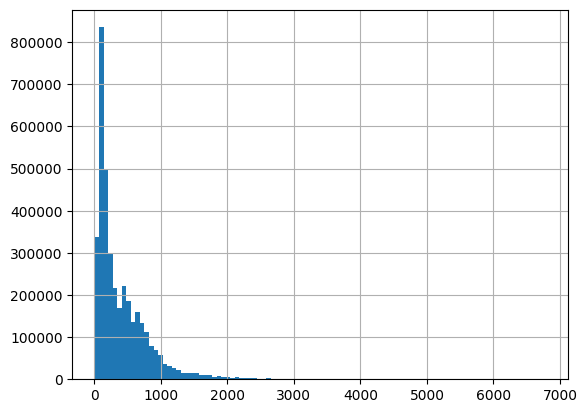

In [177]:
train_predict_df['helmet_size'] = train_predict_df.width * train_predict_df.height
train_predict_df.helmet_size.hist(bins=100)

In [178]:
# Most of the helmets are around 100
train_predict_df.helmet_size.value_counts()[:20]

90     100080
110     94734
72      91110
132     86404
156     77484
81      68339
100     68323
182     66035
56      59815
64      59664
121     58803
210     57572
144     52687
99      49756
240     48244
120     47592
80      44832
143     44513
169     44440
168     42232
Name: helmet_size, dtype: int64

In [179]:
# Few helmets shown large at videos
train_predict_df.helmet_size.value_counts()[-10:]

212     1
4575    1
5244    1
4650    1
5313    1
5304    1
5016    1
5082    1
3128    1
82      1
Name: helmet_size, dtype: int64

In [180]:
# The biggest size of helmet is 6786
train_predict_df.helmet_size.max(), train_predict_df.helmet_size.min()

(6786, 10)

In [181]:
train_predict_df.query('helmet_size == 6786')

,game_play,game_key,play_id,view,video,frame,nfl_player_id,player_label,left,width,top,height,helmet_size
752952,58218_003210,58218,3210,Sideline,58218_003210_Sideline.mp4,678,44925,H39,432,78,30,87,6786


(720, 1280, 3)


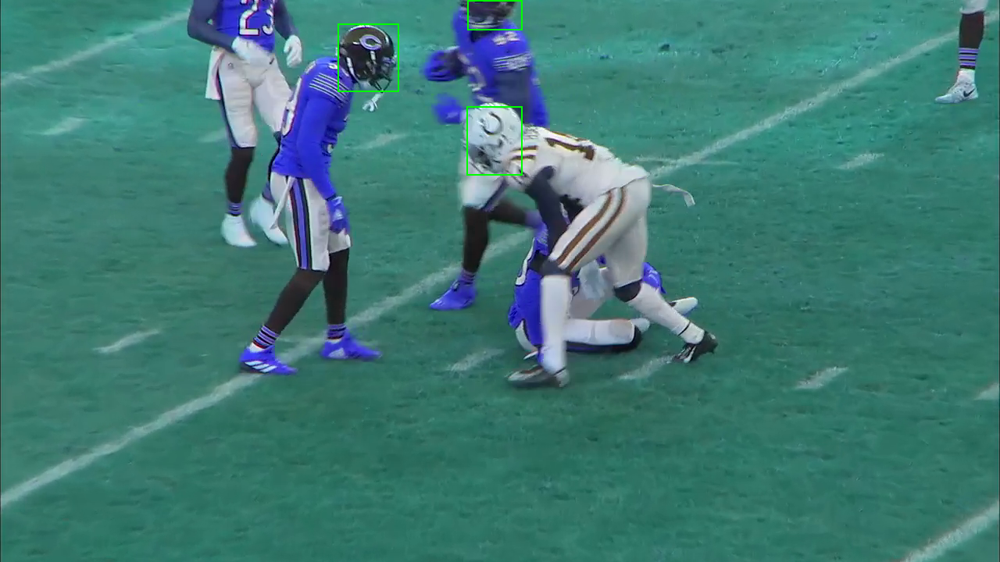

In [182]:
# when does the helmet shown the biggest?
frame_bbox(train_predict_df, '58218_003210_Sideline_678')

In [183]:
# check through the video
video('58218_003210_Sideline.mp4')

NameError: name 'video' is not defined

In [184]:
train_predict_df.query('helmet_size == 10')

,game_play,game_key,play_id,view,video,frame,nfl_player_id,player_label,left,width,top,height,helmet_size
3401144,58553_001995,58553,1995,Endzone,58553_001995_Endzone.mp4,310,42771,V43,887,2,320,5,10
3756976,58581_000040,58581,40,Endzone,58581_000040_Endzone.mp4,426,46303,V9,873,2,471,5,10
3757013,58581_000040,58581,40,Endzone,58581_000040_Endzone.mp4,427,46303,V9,874,2,471,5,10


(720, 1280, 3)


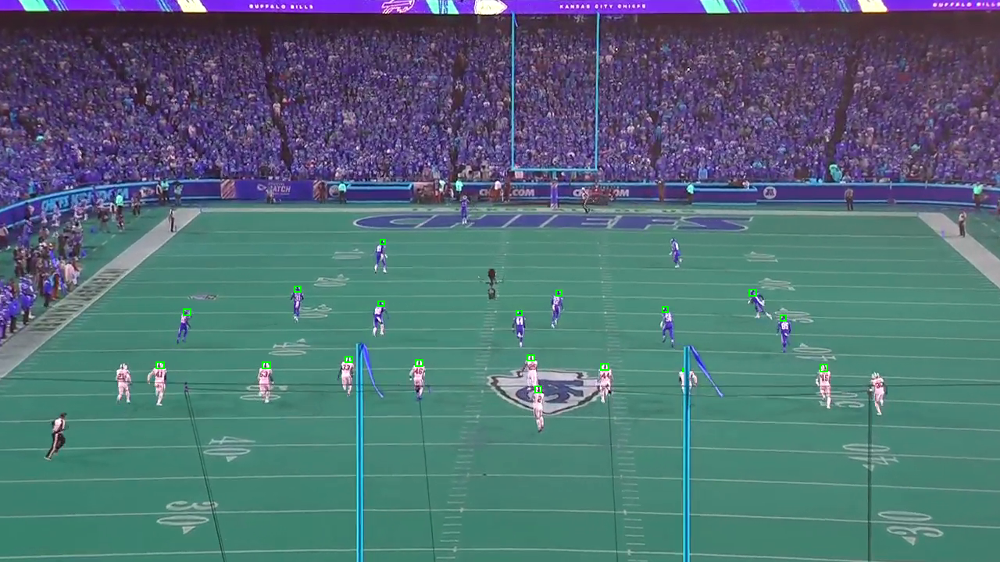

In [185]:
# when does the helmet shown the smallest?
frame_bbox(train_predict_df, '58581_000040_Endzone_426')

In [186]:
# check through the video
video('58581_000040_Endzone.mp4')

NameError: name 'video' is not defined